In [1]:
import numpy as np
import pandas as pd
import os

import utils.data_utils as du
from utils.visual import show_examples, show_image_pair
from utils.transformations import Compose, MoveAxis
from utils.dataset import CustomDataSet
from utils.prediction import predict_batch
from torch.utils.data import DataLoader
import models
import torch
import random
import matplotlib.pyplot as plt



In [2]:
from skimage import io

def prepare_retina_data_custom(root_path, data_distrib_path, as_gray = False, normalize = True):
    #assert split == "train" or split == "val" or split == "test", "Only train/val/test splits are allowed"
    df = pd.read_csv(data_distrib_path)
    # no split    
    imglist, masklist1, masklist2, = [], [], []
    for fl, mfl1, mfl2, in zip(df["images"].to_list(), df["masks_annotator1"].to_list(), df["masks_annotator2"].to_list()):
        fpath = os.path.join(root_path, fl)
        mpath1 = os.path.join(root_path, mfl1)
        mpath2 = os.path.join(root_path, mfl2)
        
        # io rescales images in range [0,1] when as_gray = True
        img = io.imread(fpath,  as_gray=as_gray) 
        mask1 = io.imread(mpath1)  # masks are loaded in 2d format
        mask2 = io.imread(mpath2)  # masks are loaded in 2d format
        imglist.append(img)
        masklist1.append(mask1)
        masklist2.append(mask2)
    
    img_array = np.stack(imglist)
    mask_array1 = np.stack(masklist1)
    mask_array2 = np.stack(masklist2)

    return img_array, mask_array1, mask_array2, df["images"].to_list() 

In [3]:
root_dir = "../data/CHASEDB1"
datafile = "../data/retina_data.csv"

all_data, all_masks1, all_masks2, titles = prepare_retina_data_custom(root_path = root_dir, 
                                                                data_distrib_path = datafile, 
                                                                as_gray = False)
                                                                

du.print_info(all_data)
du.print_info(all_masks1)
du.print_info(all_masks1)
print(titles)

arr.shape=(28, 960, 999, 3)  arr.max()=255   arr.min()=0  arr.mean()=54.804549489966156 arr.dtype=dtype('uint8')
arr.shape=(28, 960, 999)  arr.max()=True   arr.min()=False  arr.mean()=0.06933920527670527 arr.dtype=dtype('bool')
arr.shape=(28, 960, 999)  arr.max()=True   arr.min()=False  arr.mean()=0.06933920527670527 arr.dtype=dtype('bool')
['Image_01L.jpg', 'Image_01R.jpg', 'Image_02L.jpg', 'Image_02R.jpg', 'Image_03L.jpg', 'Image_03R.jpg', 'Image_04L.jpg', 'Image_04R.jpg', 'Image_05L.jpg', 'Image_05R.jpg', 'Image_06L.jpg', 'Image_06R.jpg', 'Image_07L.jpg', 'Image_07R.jpg', 'Image_08L.jpg', 'Image_08R.jpg', 'Image_09L.jpg', 'Image_09R.jpg', 'Image_10L.jpg', 'Image_10R.jpg', 'Image_11L.jpg', 'Image_11R.jpg', 'Image_12L.jpg', 'Image_12R.jpg', 'Image_13L.jpg', 'Image_13R.jpg', 'Image_14L.jpg', 'Image_14R.jpg']


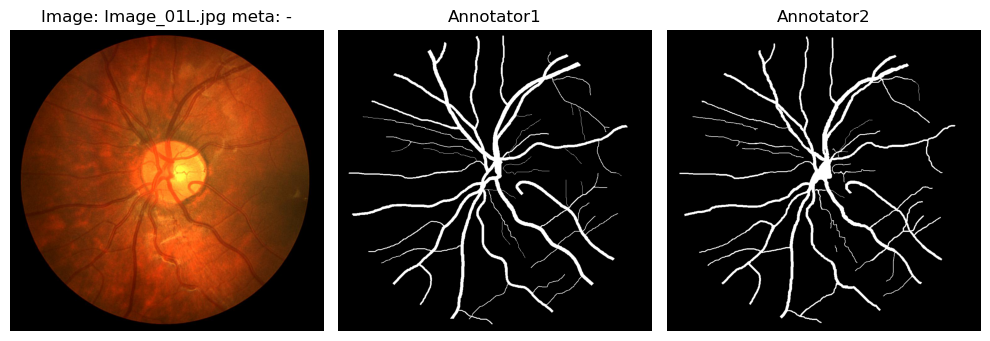

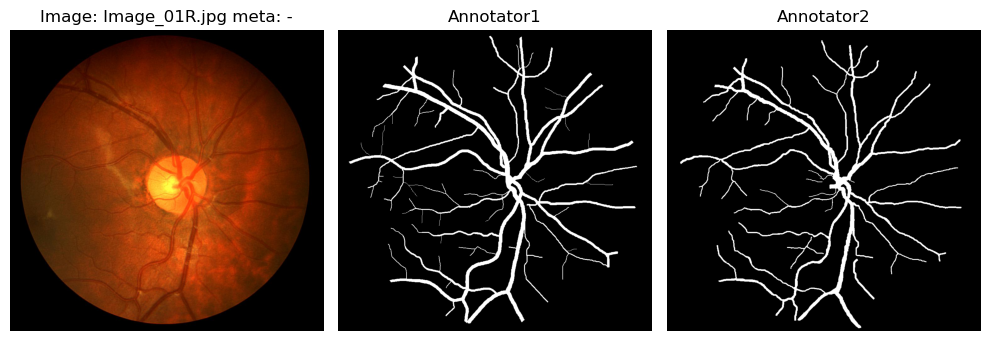

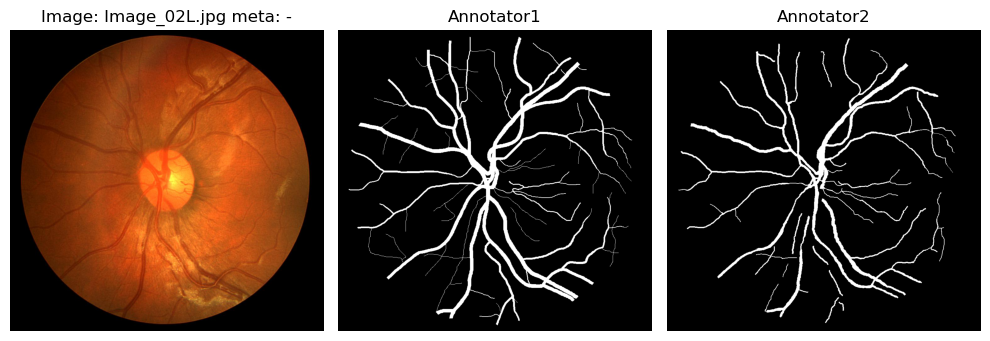

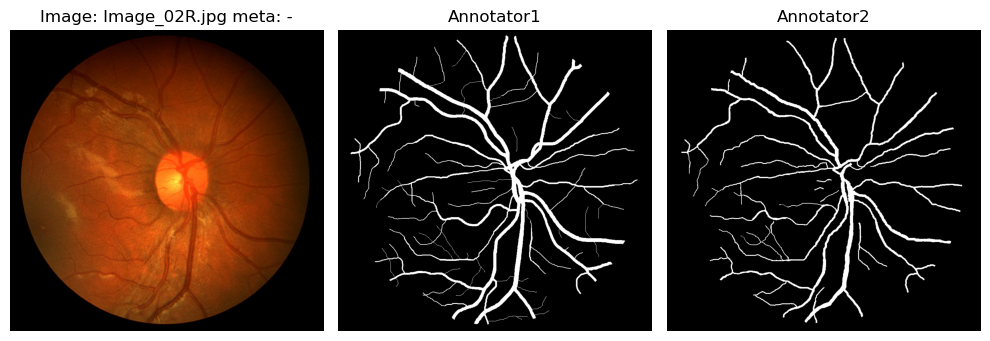

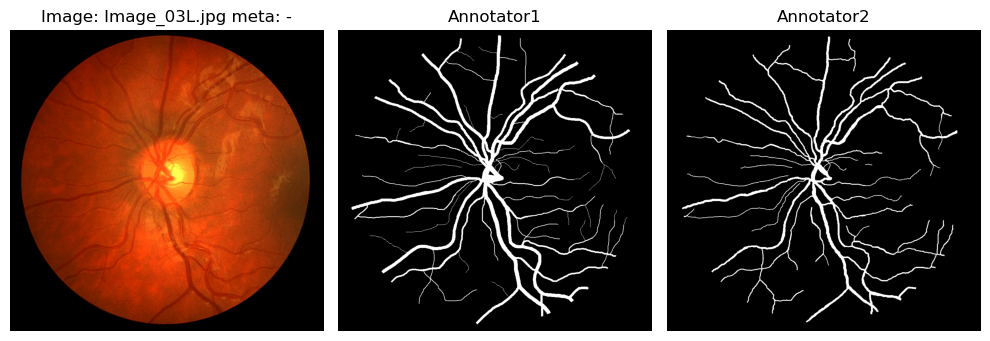

...

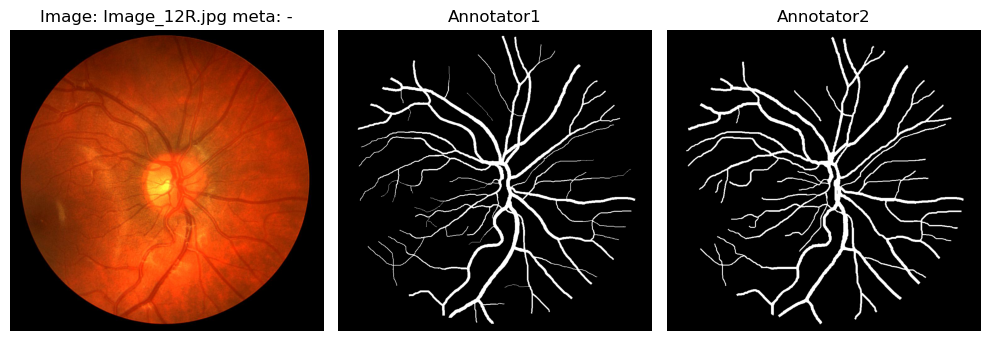

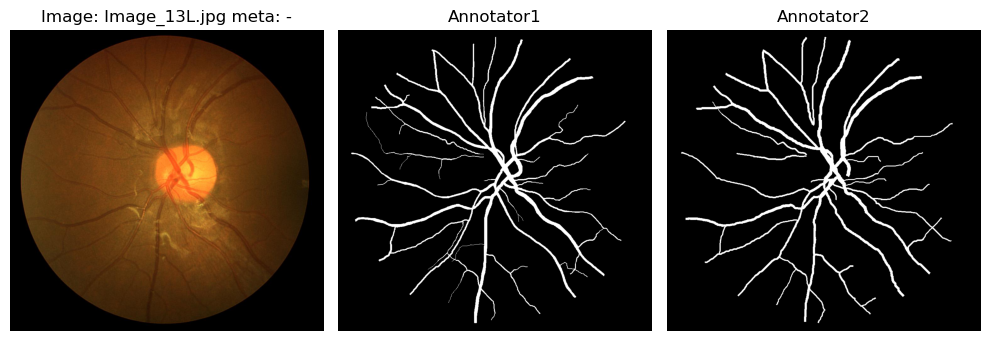

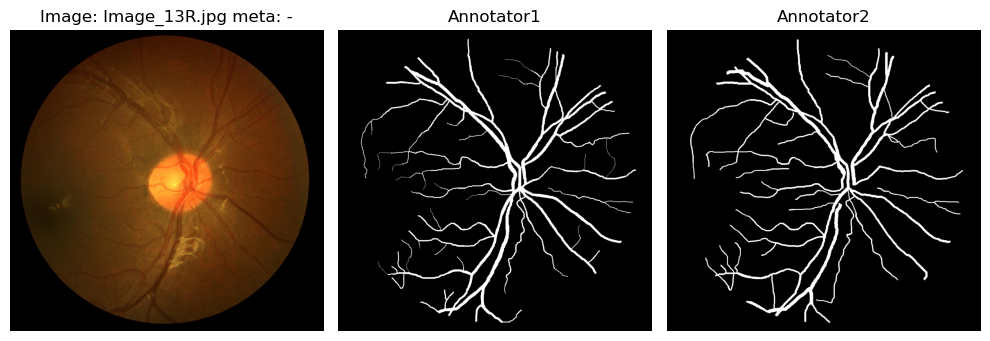

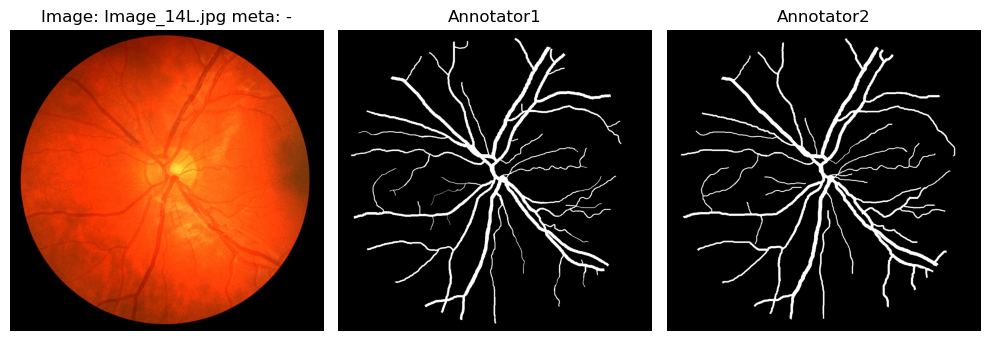

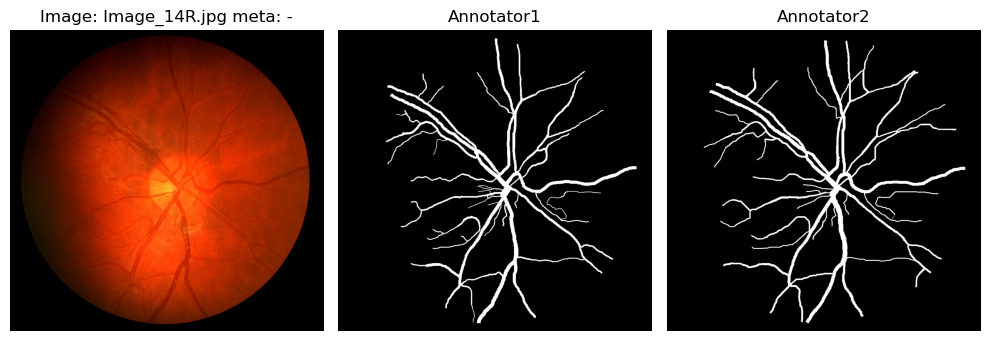

In [4]:
for title, img, msk1, msk2 in zip(titles, all_data, all_masks1, all_masks2):
    show_examples(name = title, image = img, mask = msk1, gt = msk2, cline = "-", imtitle = "Image", msk1_title = "Annotator1", msk2_title = "Annotator2" )

## Retriving data splits

In [5]:
root_dir = "../data/CHASEDB1"
datafile = "../data/retina_data.csv"

train_data, train_masks, train_idx = du.prepare_retina_data(split = "train", 
                                                                root_path = root_dir, 
                                                                data_distrib_path = datafile, 
                                                                as_gray = False, 
                                                                normalize = True) 


val_data, val_masks, val_idx = du.prepare_retina_data(split = "val", 
                                                                root_path = root_dir, 
                                                                data_distrib_path = datafile, 
                                                                as_gray = False, 
                                                                normalize = True)

test_data, test_masks, test_idx = du.prepare_retina_data(split = "test", 
                                                                root_path = root_dir, 
                                                                data_distrib_path = datafile, 
                                                                as_gray = False, 
                                                                normalize = True)       

du.print_info(train_data)
du.print_info(train_masks)

du.print_info(val_data)
du.print_info(val_masks)

du.print_info(test_data)
du.print_info(test_masks)

arr.shape=(18, 960, 999, 3)  arr.max()=1.0   arr.min()=0.0  arr.mean()=0.2053473074108962 arr.dtype=dtype('float64')
arr.shape=(18, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.06820338857375895 arr.dtype=dtype('uint8')
arr.shape=(4, 960, 999, 3)  arr.max()=1.0   arr.min()=0.0  arr.mean()=0.22440164395059525 arr.dtype=dtype('float64')
arr.shape=(4, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.06763351893560227 arr.dtype=dtype('uint8')
arr.shape=(6, 960, 999, 3)  arr.max()=1.0   arr.min()=0.0  arr.mean()=0.23731605743361353 arr.dtype=dtype('float64')
arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.07109435824713603 arr.dtype=dtype('uint8')


## Training set

COARSE


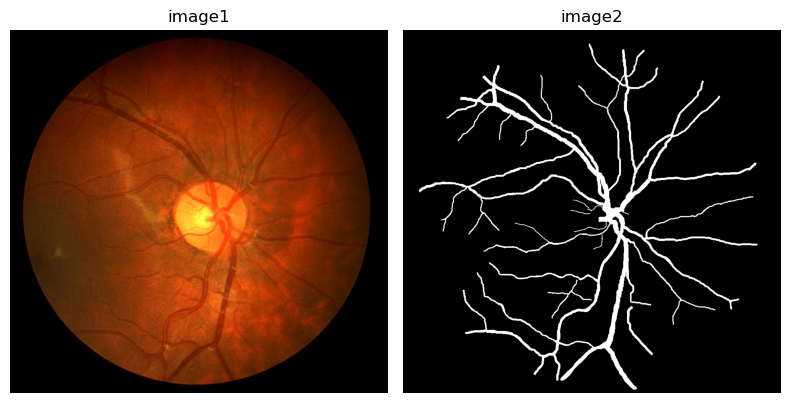

FINE


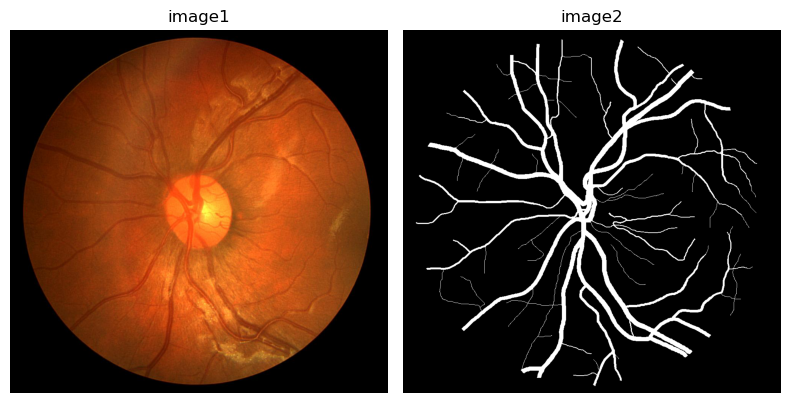

COARSE


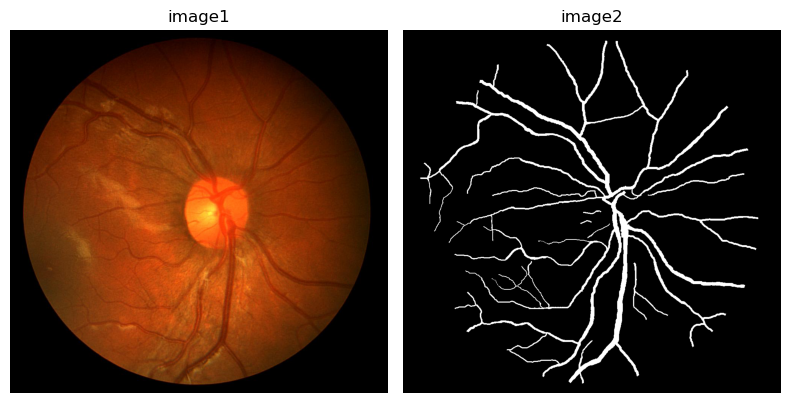

COARSE


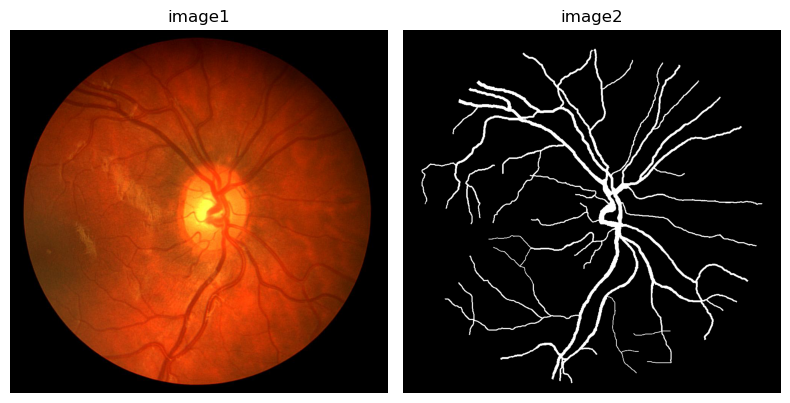

FINE


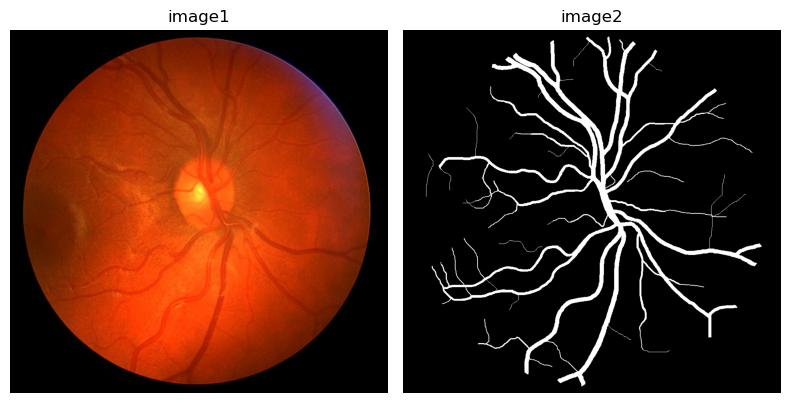

COARSE


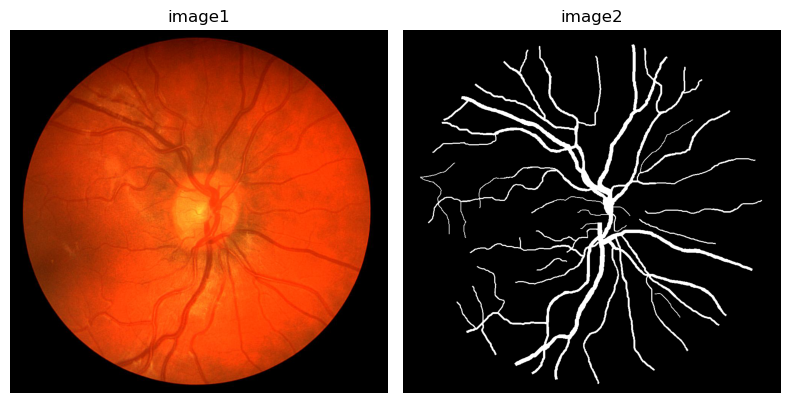

FINE


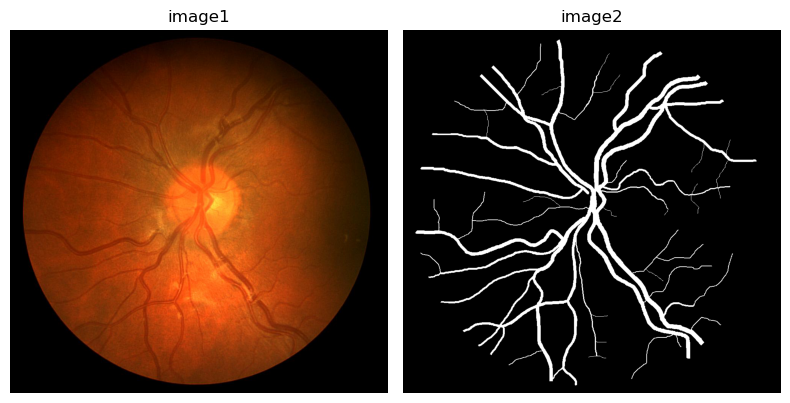

COARSE


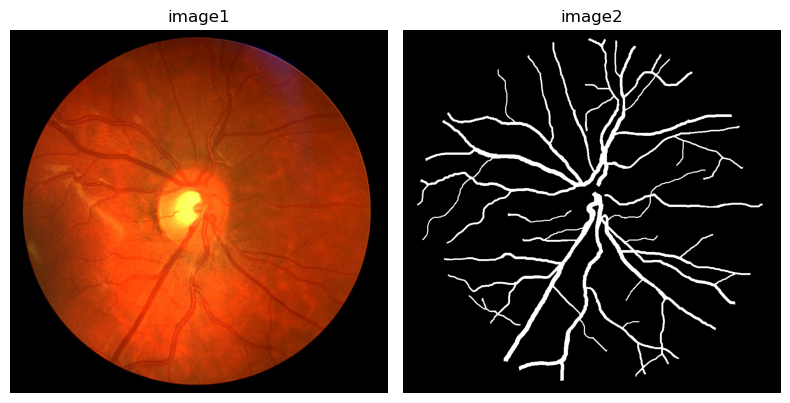

FINE


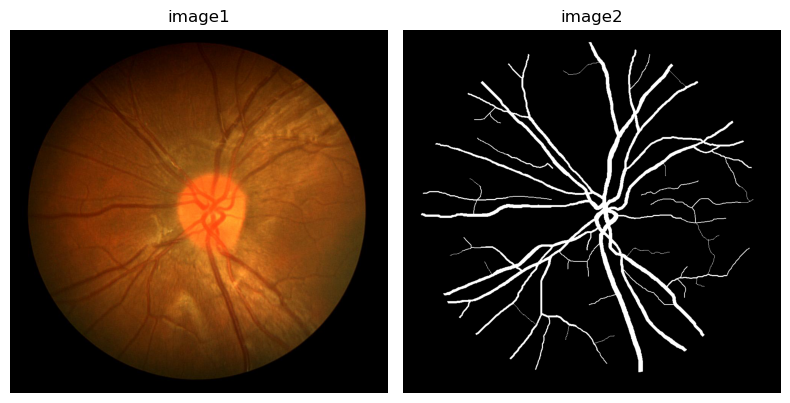

COARSE


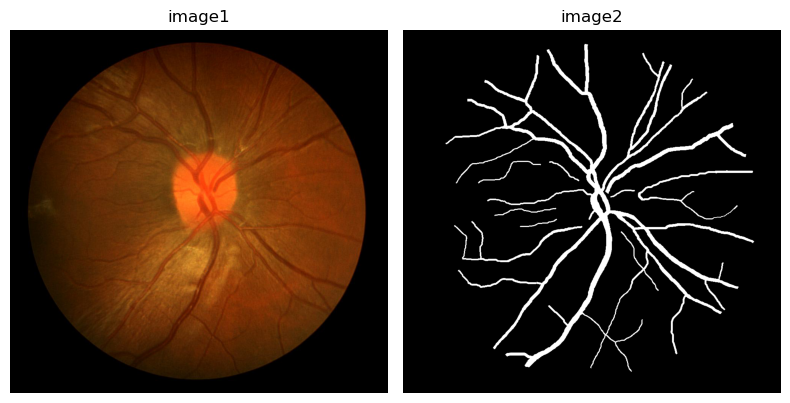

COARSE


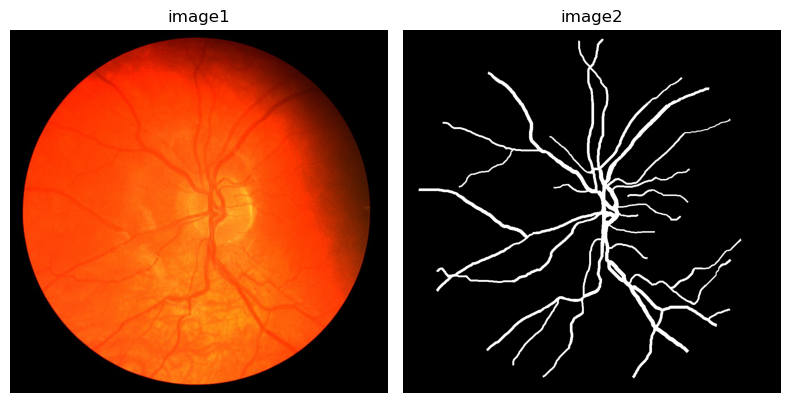

COARSE


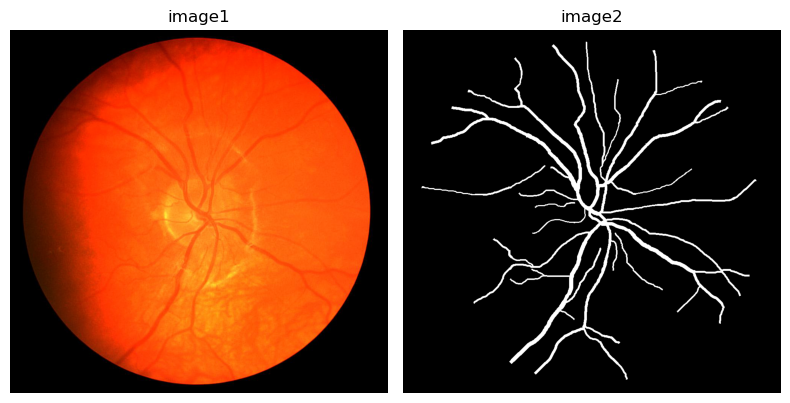

FINE


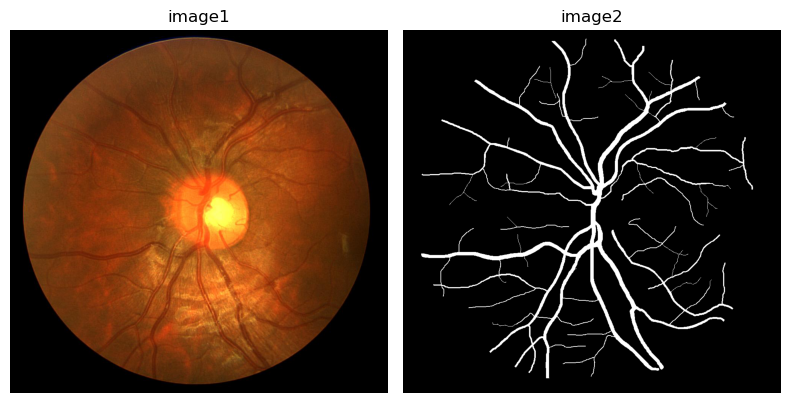

COARSE


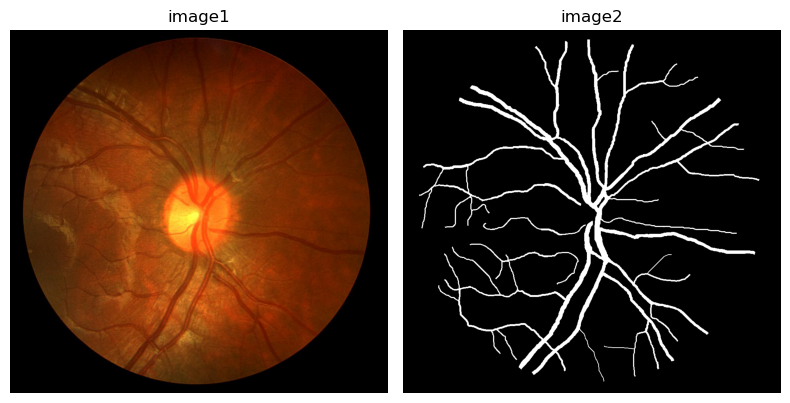

COARSE


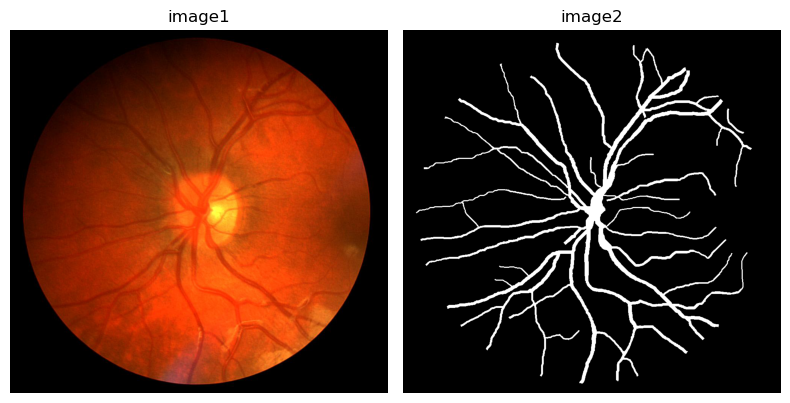

COARSE


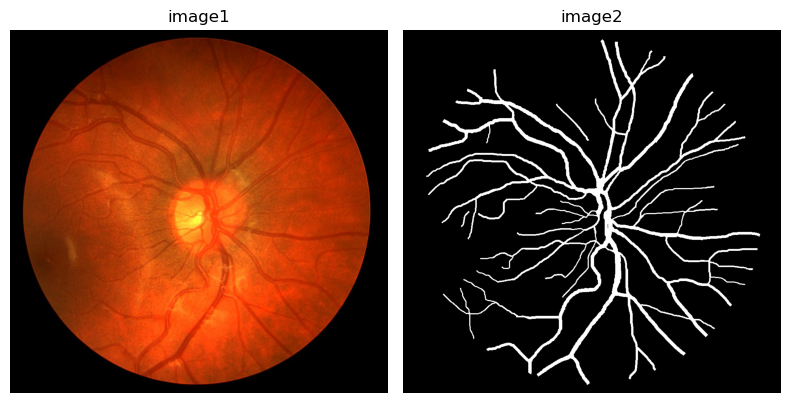

FINE


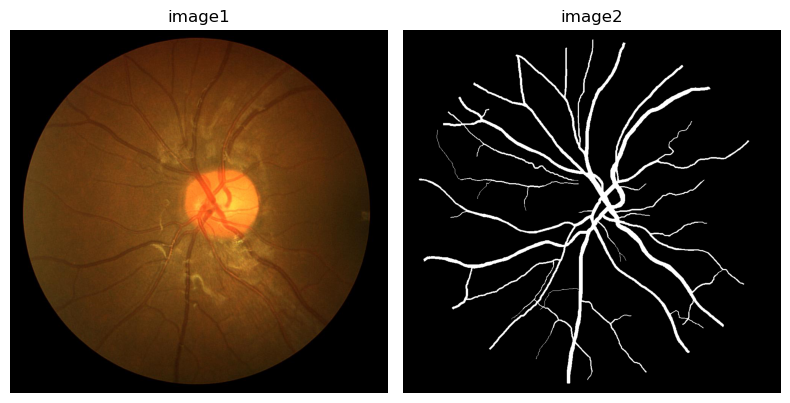

COARSE


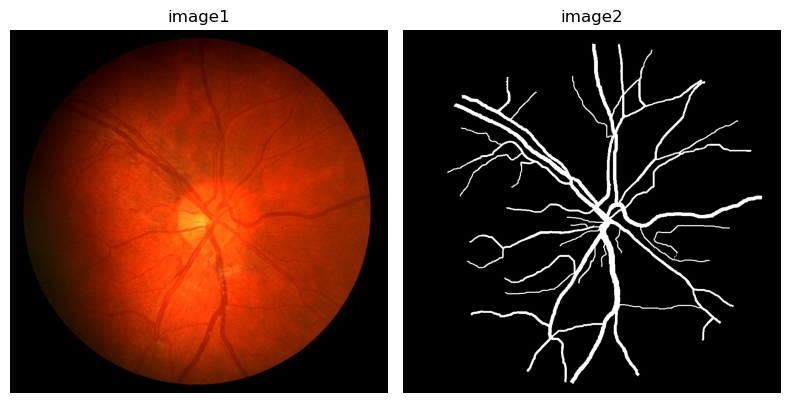

In [6]:
for img, msk, idx in zip(train_data, train_masks, train_idx):
    print(idx)
    show_image_pair(img, msk, cmap = 'gray', figsize=(8,5)) 

## Validation set

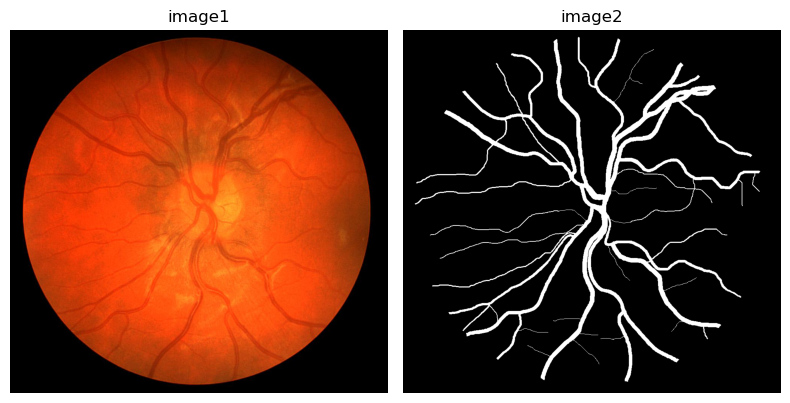

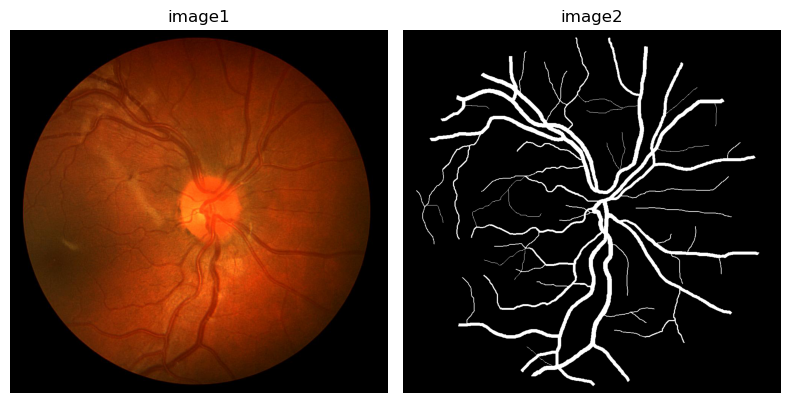

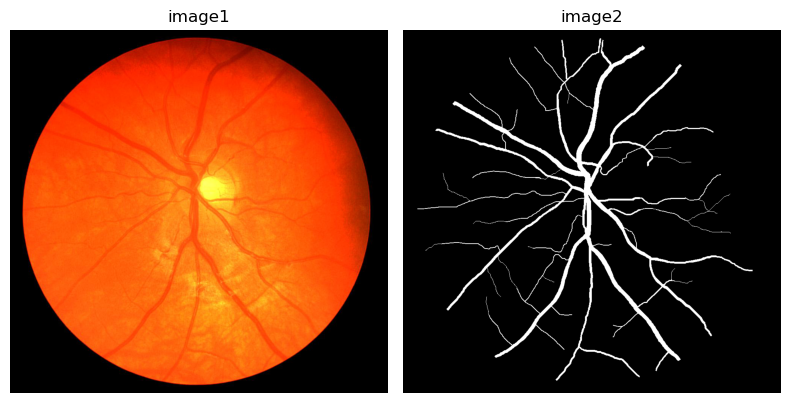

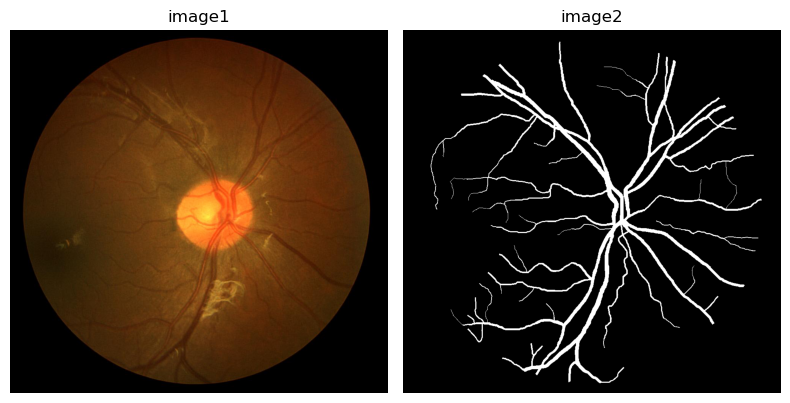

In [7]:
for img, msk, idx in zip(val_data, val_masks, val_idx):
    #print(idx)
    show_image_pair(img, msk, cmap = 'gray', figsize=(8,5)) 

## Test set

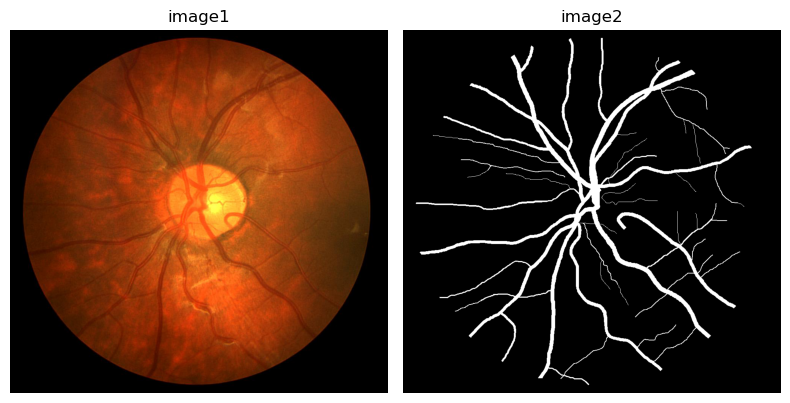

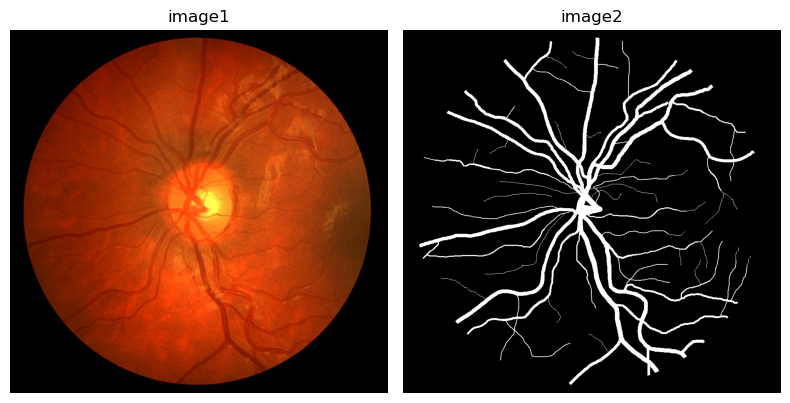

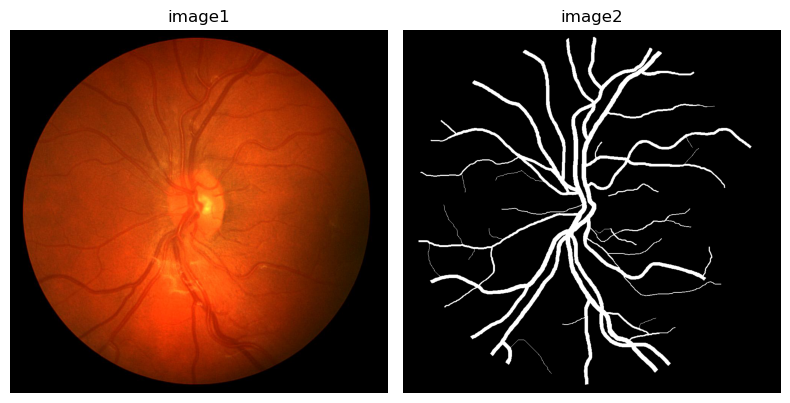

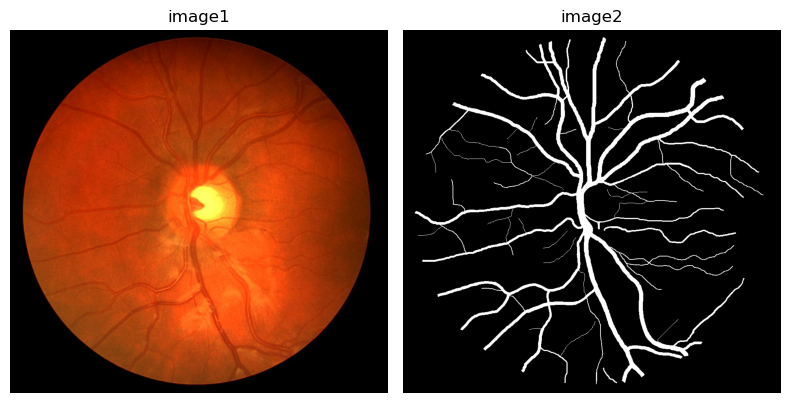

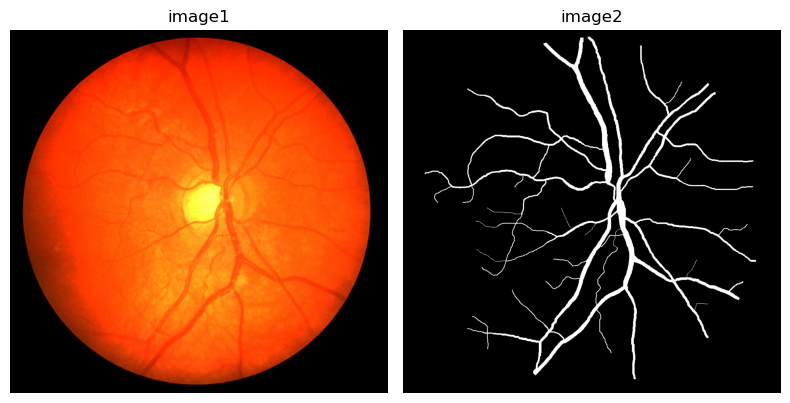

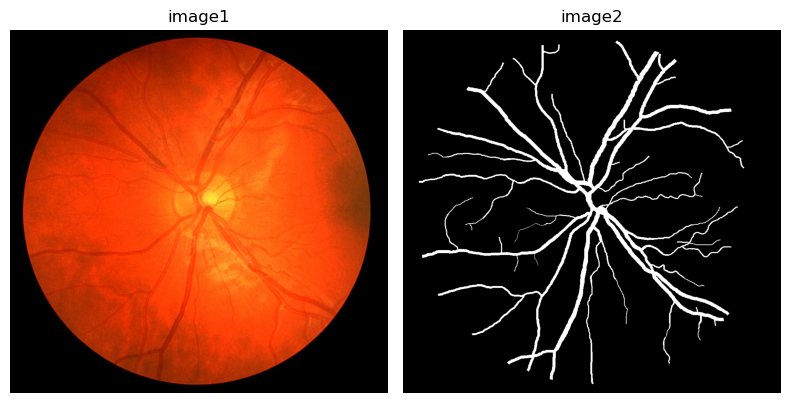

In [8]:
for img, msk, idx in zip(test_data, test_masks, test_idx):
    #print(idx)
    show_image_pair(img, msk, cmap = 'gray', figsize=(8,5)) 

## Predictions

In [9]:
import numpy as np
import pandas as pd
import os

import utils.data_utils as du
from utils.visual import show_examples, show_image_pair, overlap
from utils.transformations import Compose, MoveAxis
from utils.dataset import CustomDataSet
from utils.prediction import predict_batch
from torch.utils.data import DataLoader
import models
import torch
import random
import matplotlib.pyplot as plt

root_dir = "../data/CHASEDB1"
datafile = "../data/retina_data.csv"

root_exp = "../experiments"
saved_models = "saved_models"



### reference subset 1/3 of data

In [10]:
batch_size=8
metamap = du.create_polygon_map_retina() 
transforms_test = Compose([
        MoveAxis()
    ])


test_data, test_masks, test_idx = du.prepare_retina_data(split = "test", 
                                                                root_path = root_dir, 
                                                                data_distrib_path = datafile, 
                                                                as_gray = False, 
                                                                normalize = True)       



du.print_info(test_data)
du.print_info(test_masks)

dataset_test = CustomDataSet(inputs=test_data,
                                        targets=test_masks,
                                        metalabels=test_idx,
                                        mmap = metamap,
                                        transform=transforms_test)

    
print(f"{len(dataset_test) = }") 

dataloader_test = DataLoader(dataset=dataset_test,
                                    batch_size=batch_size,
                                    shuffle=False)

print(f"{len(dataloader_test) = }")
print("Data prepared")

arr.shape=(6, 960, 999, 3)  arr.max()=1.0   arr.min()=0.0  arr.mean()=0.23731605743361353 arr.dtype=dtype('float64')
arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.07109435824713603 arr.dtype=dtype('uint8')
len(dataset_test) = 6
len(dataloader_test) = 1
Data prepared


In [12]:
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')
    print("cpu device engaged")

model_restored = models.UNet3SEb(n_channels=3, n_classes=2, bilinear=False).to(device) # type: ignore 

exp = "reference_sub"
best_model = "best_model.pt"
model_name = os.path.join(root_exp, exp, saved_models, best_model)
print(model_name)
model_weights = torch.load(model_name)    
model_restored.load_state_dict(model_weights)
print("Model restored")



../experiments/reference_sub/saved_models/best_model.pt
Model restored


In [ ]:
predictions = predict_batch(model_restored, dataloader_test, device, with_meta = False, regression = False, dtype = "uint8" )

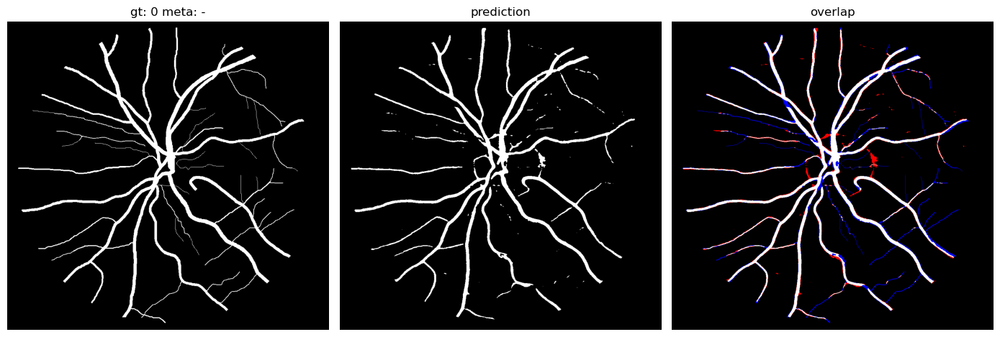

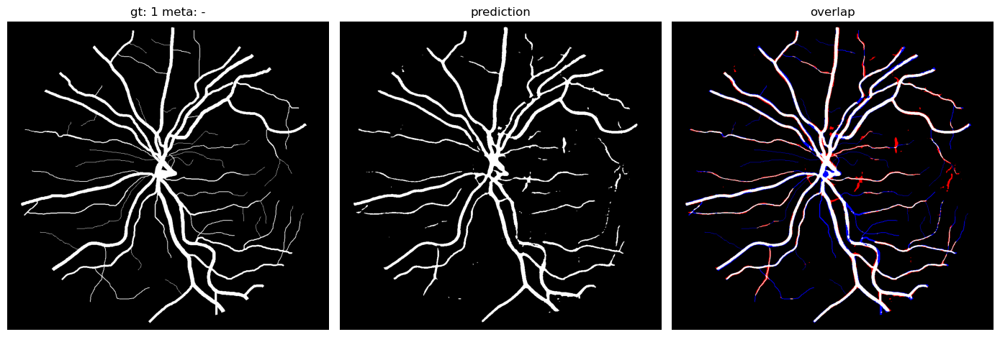

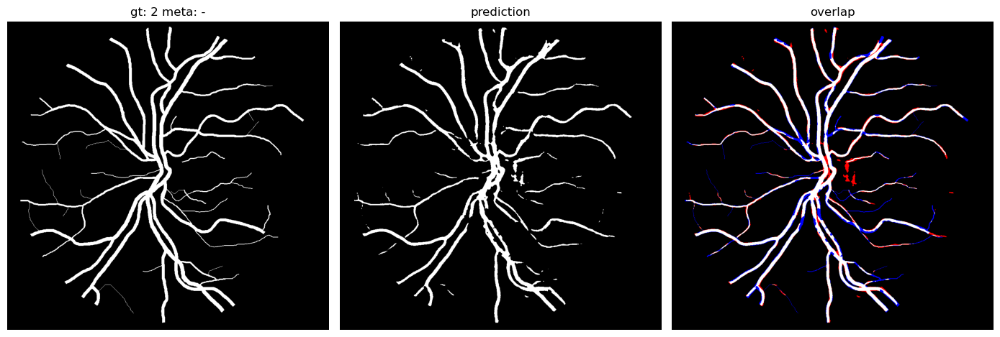

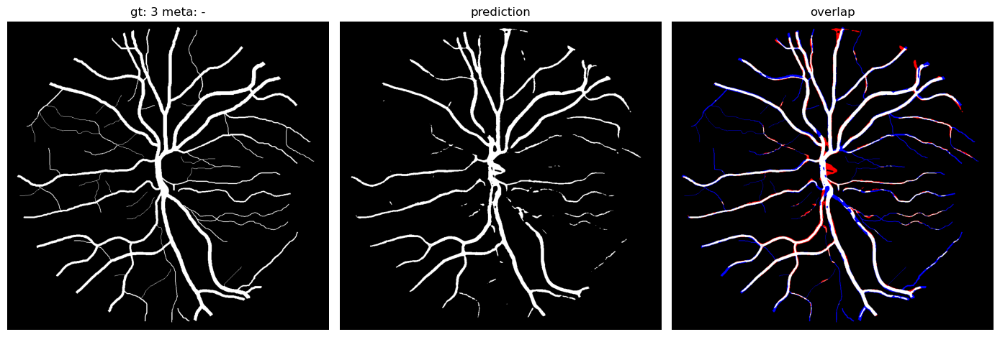

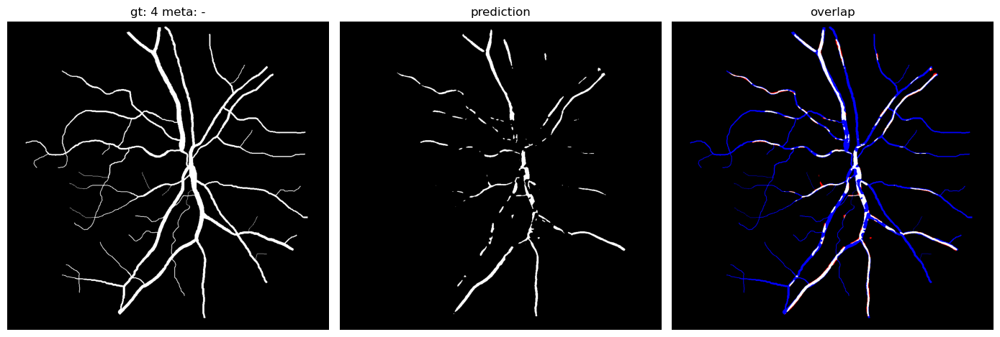

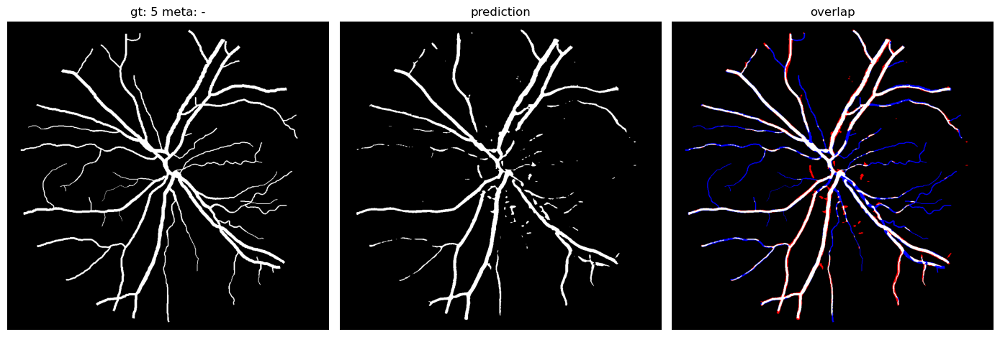

In [14]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

## Reference - all data

In [15]:
model_restored = models.UNet3SEb(n_channels=3, n_classes=2, bilinear=False).to(device) # type: ignore 

exp = "reference"
best_model = "best_model.pt"
model_name = os.path.join(root_exp, exp, saved_models, best_model)
print(model_name)
model_weights = torch.load(model_name)    
model_restored.load_state_dict(model_weights)
print("Model restored")

../experiments/reference/saved_models/best_model.pt
Model restored


In [16]:
predictions = predict_batch(model_restored, dataloader_test, device, with_meta = False, regression = False, dtype = "uint8" )
du.print_info(predictions)

arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.0628395756867979 arr.dtype=dtype('uint8')


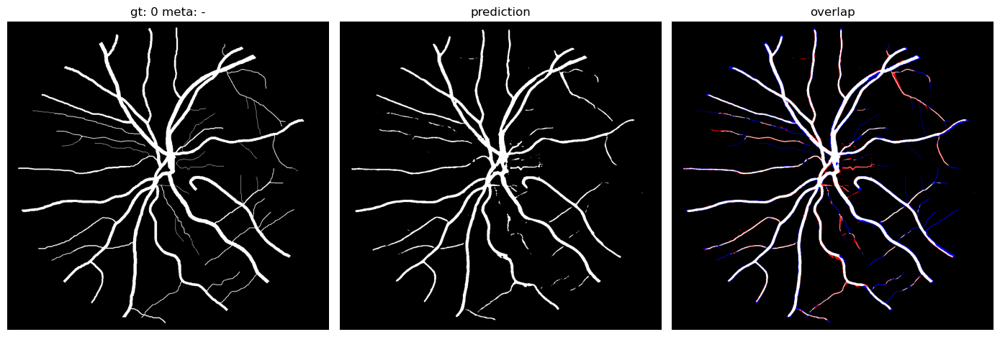

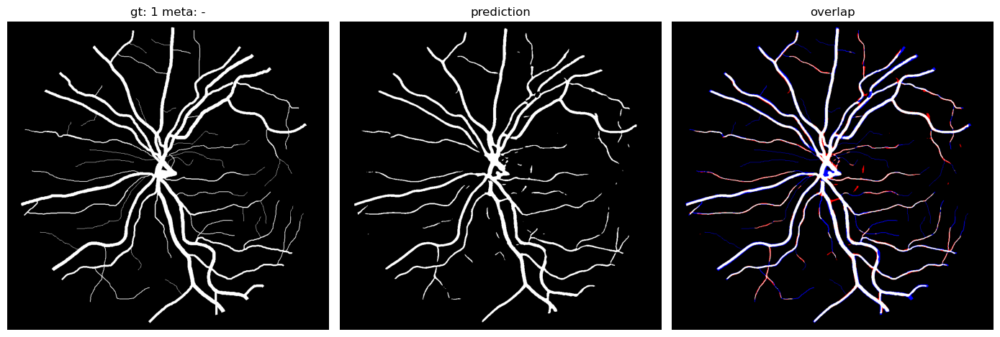

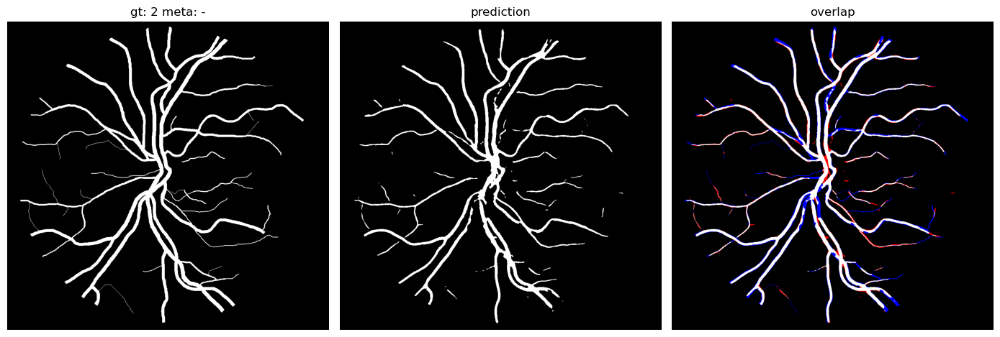

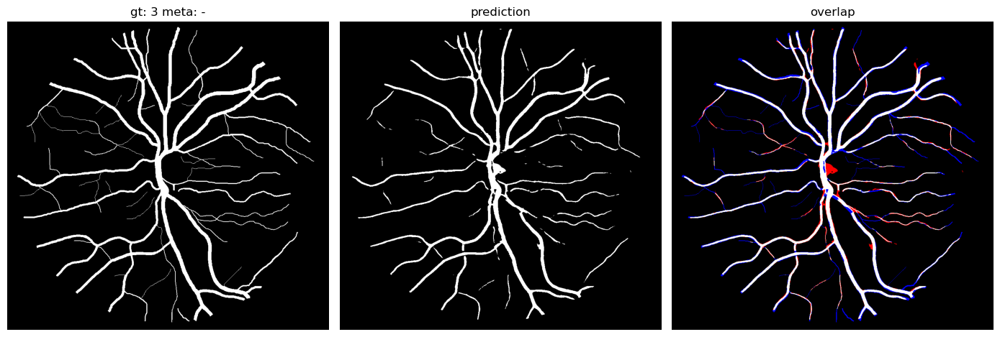

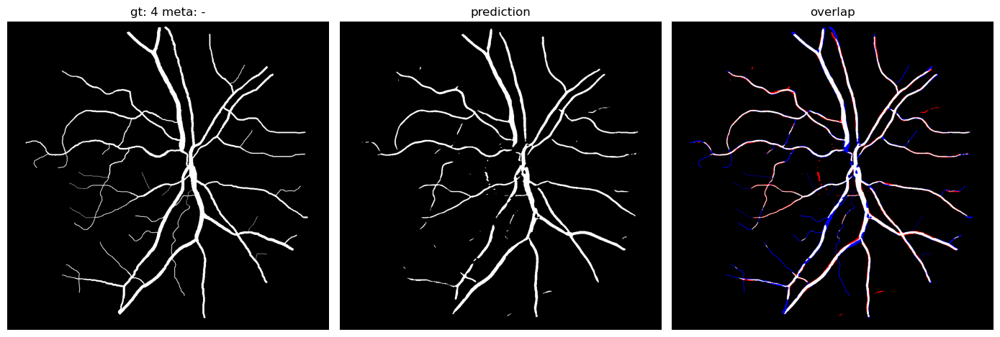

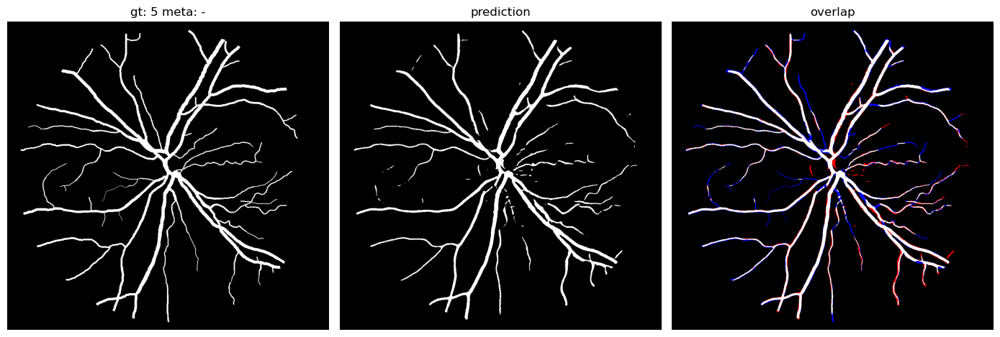

In [17]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

## Reference - SME dummy

In [18]:
model_restored = models.UNet3SEbMetaSE(n_channels=3, n_classes=2, meta_length = 2, bilinear=False).to(device)  

exp = "sme_dummy"
best_model = "best_model.pt"
model_name = os.path.join(root_exp, exp, saved_models, best_model)
print(model_name)
model_weights = torch.load(model_name)    
model_restored.load_state_dict(model_weights)
print("Model restored")

../experiments/sme_dummy/saved_models/best_model.pt
Model restored


In [19]:
predictions = predict_batch(model_restored, dataloader_test, device, with_meta = True, regression = False, dtype = "uint8" )
du.print_info(predictions)

arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.0693629393282171 arr.dtype=dtype('uint8')


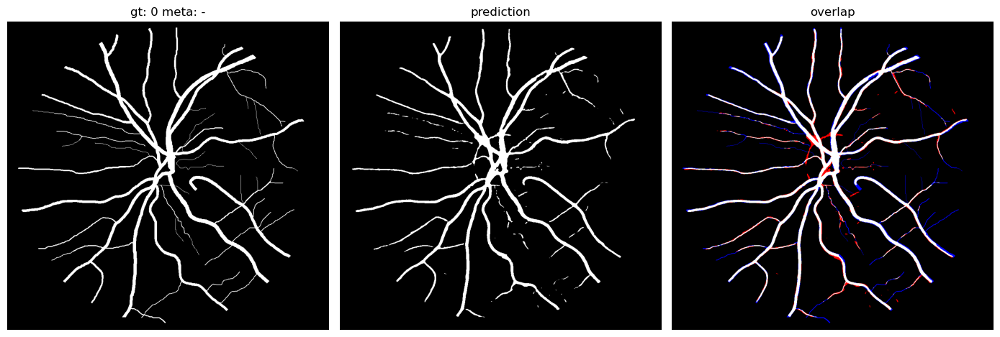

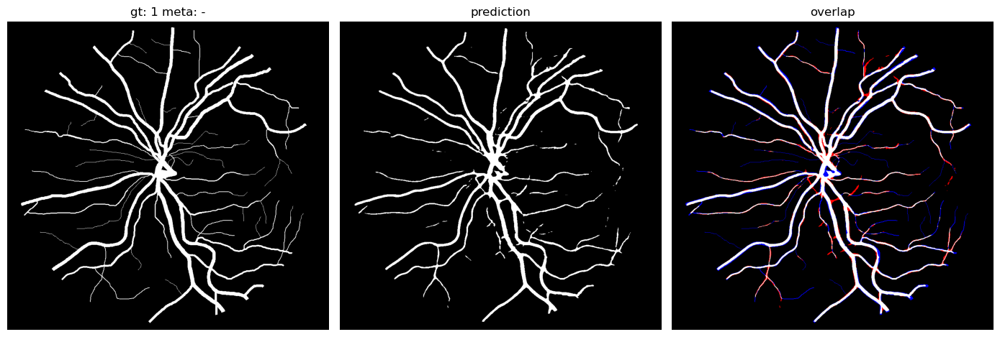

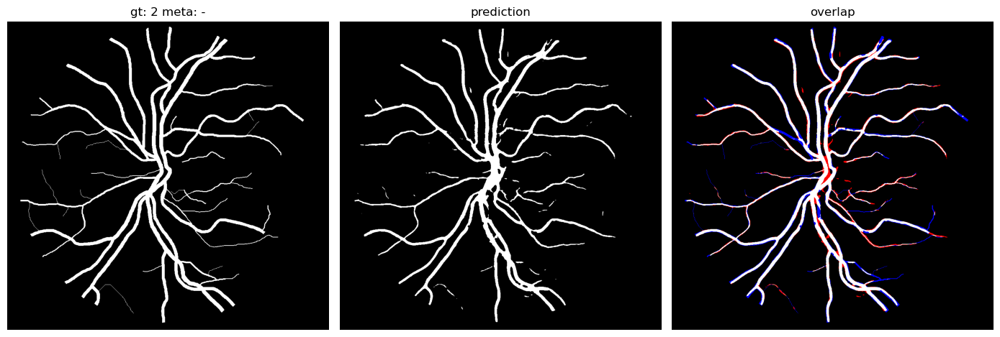

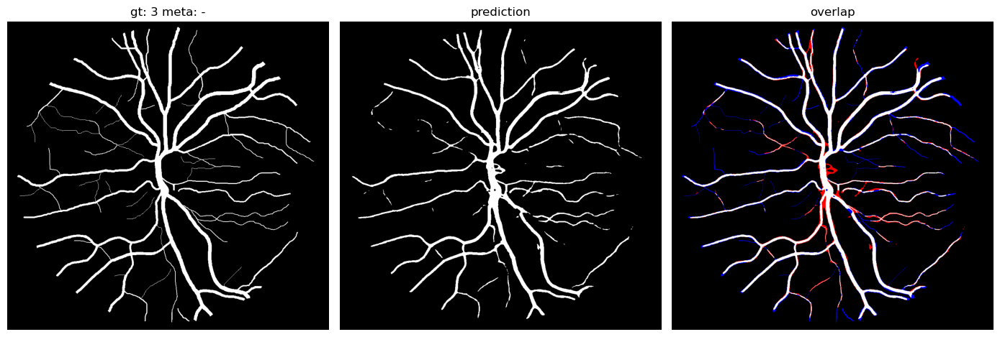

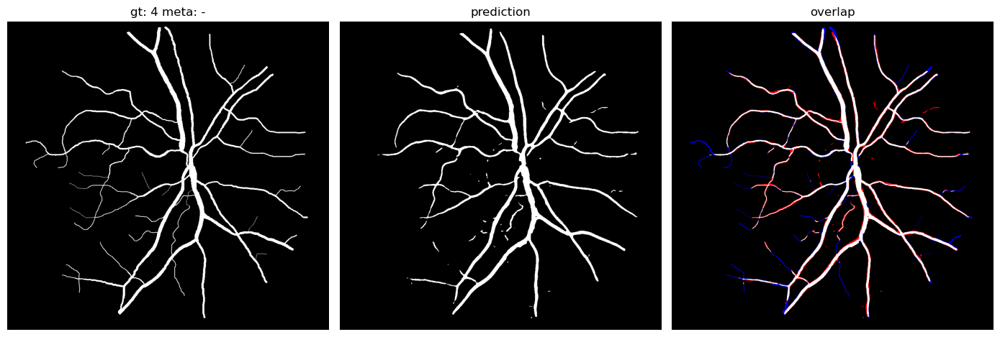

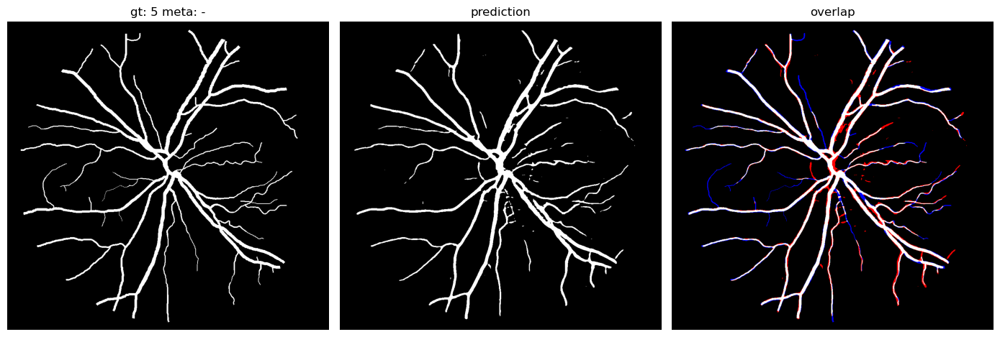

In [20]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

## FiLM model - with metadata

In [21]:
model_restored = models.UNet3FILM(n_channels=3, n_classes=2, meta_length = 2, bilinear=False).to(device)

exp = "film"
best_model = "best_model.pt"
model_name = os.path.join(root_exp, exp, saved_models, best_model)
print(model_name)
model_weights = torch.load(model_name)    
model_restored.load_state_dict(model_weights)
print("Model restored")

../experiments/film/saved_models/best_model.pt
Model restored


In [22]:
predictions = predict_batch(model_restored, dataloader_test, device, with_meta = True, regression = False, dtype = "uint8" )
du.print_info(predictions)


arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.06450391363585808 arr.dtype=dtype('uint8')


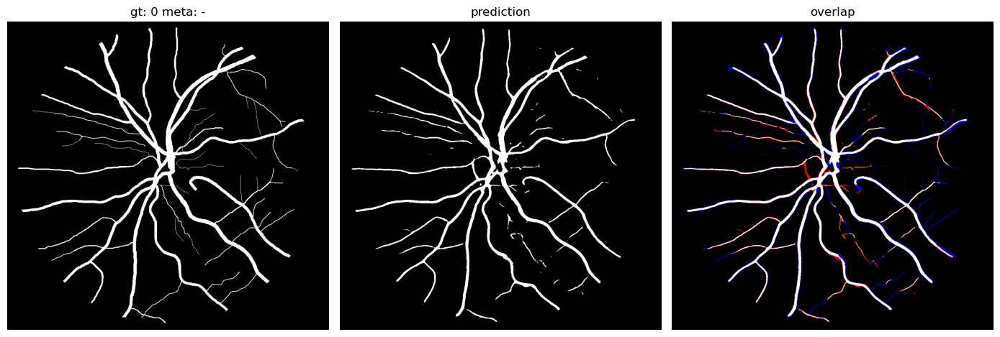

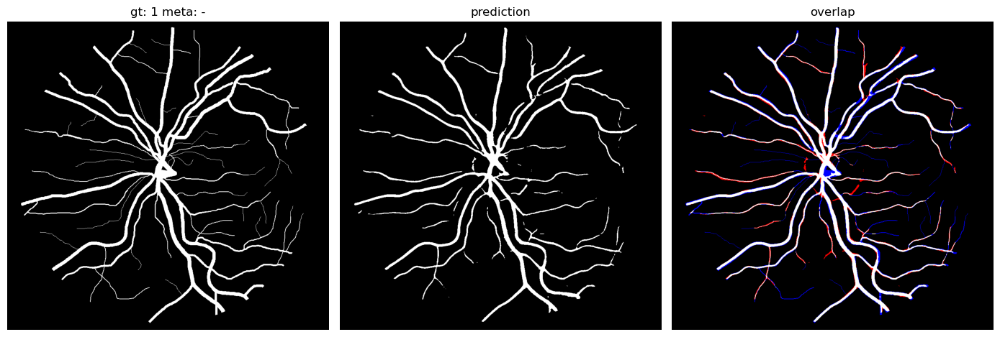

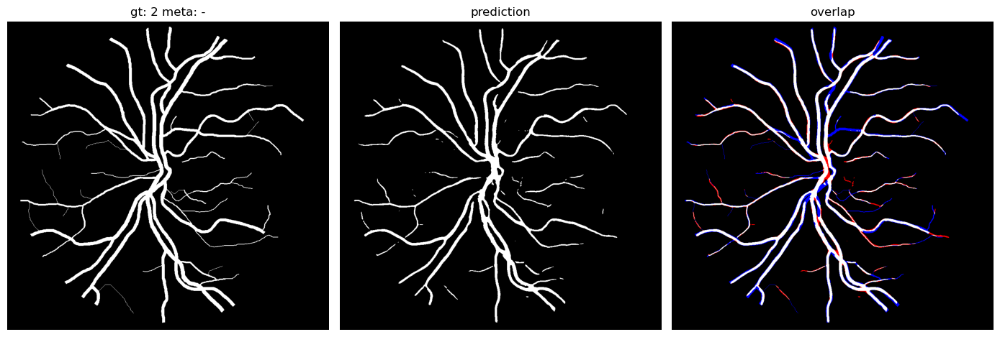

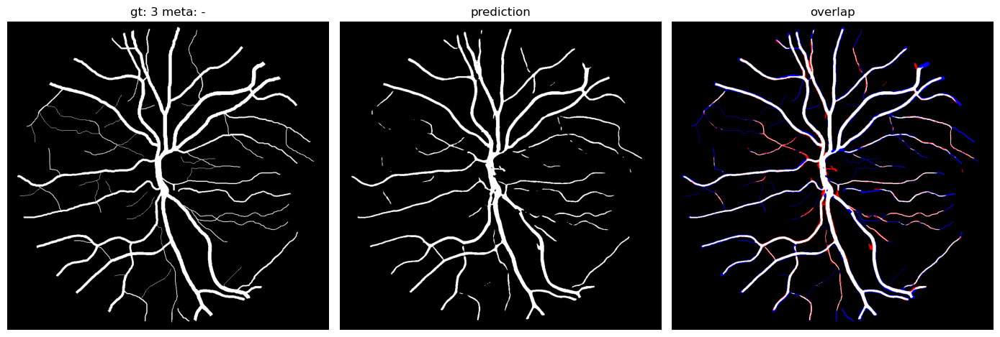

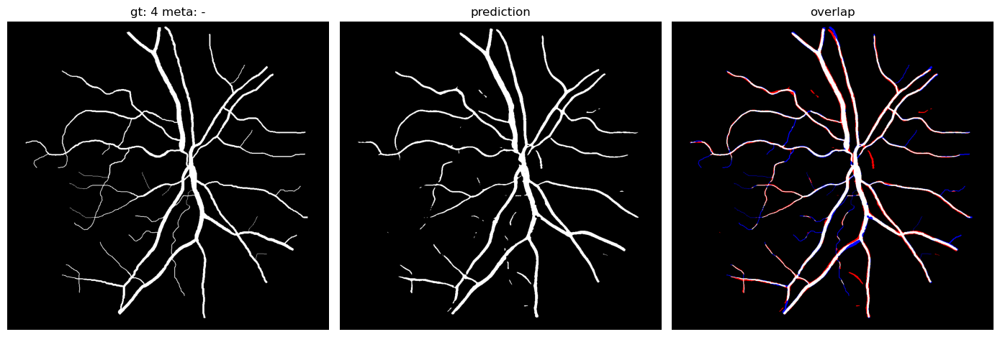

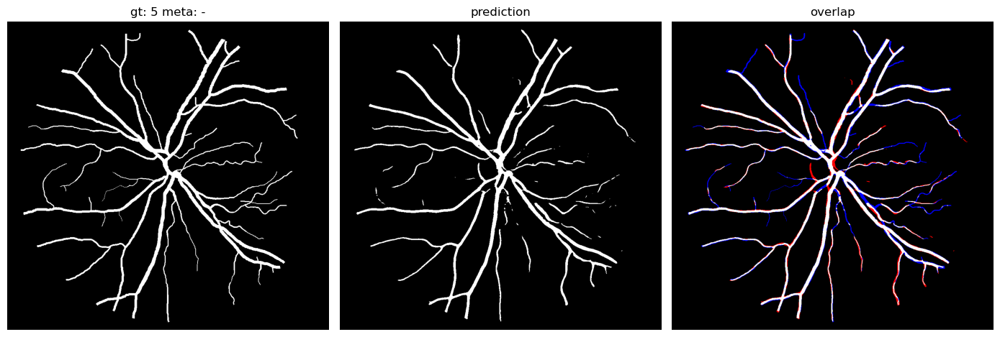

In [23]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

## ME model - with metadata

In [24]:
model_restored = models.UNet3SEbMetaOnly(n_channels=3, n_classes=2, meta_length = 2, bilinear=False).to(device) 

exp = "me"
best_model = "best_model.pt"
model_name = os.path.join(root_exp, exp, saved_models, best_model)
print(model_name)
model_weights = torch.load(model_name)    
model_restored.load_state_dict(model_weights)
print("Model restored")

../experiments/me/saved_models/best_model.pt
Model restored


In [25]:
predictions = predict_batch(model_restored, dataloader_test, device, with_meta = True, regression = False, dtype = "uint8" )
du.print_info(predictions)


arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.06607041068846624 arr.dtype=dtype('uint8')


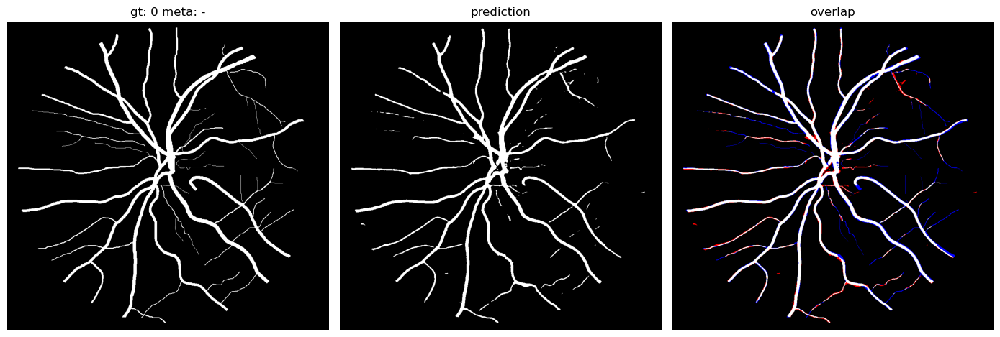

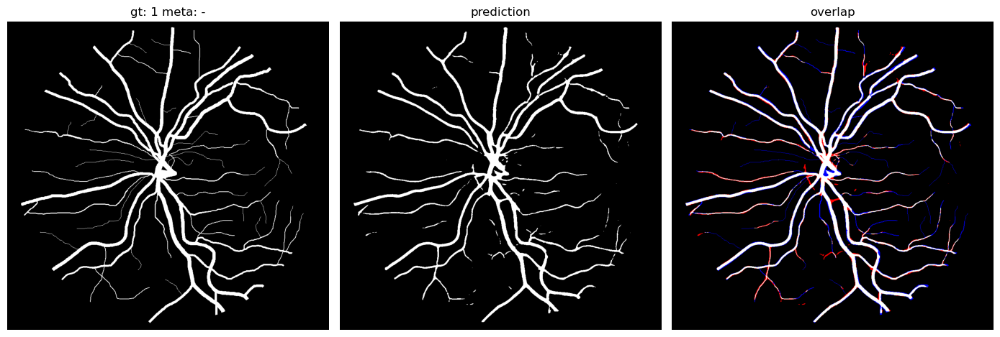

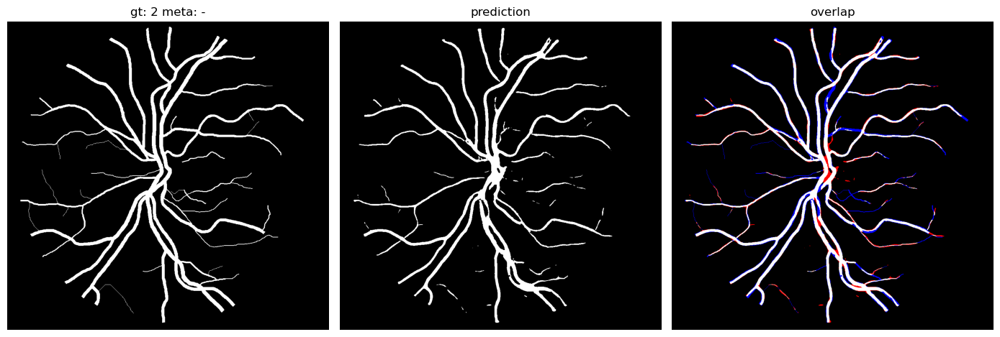

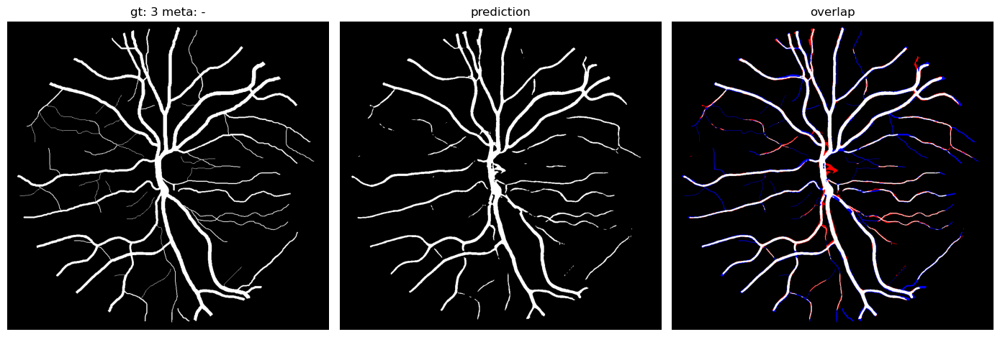

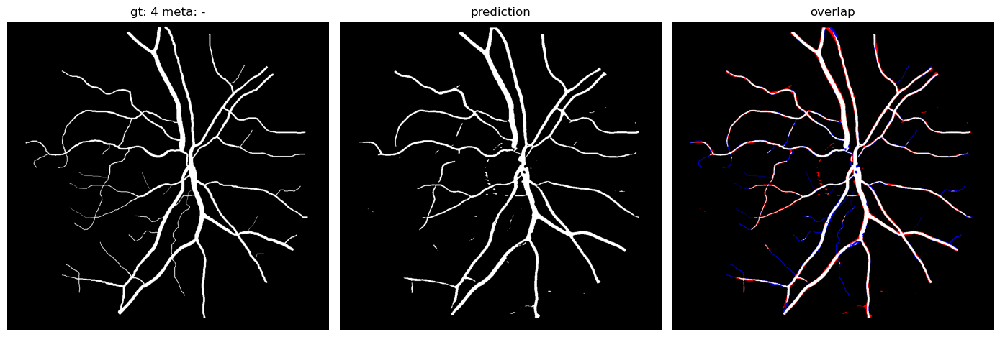

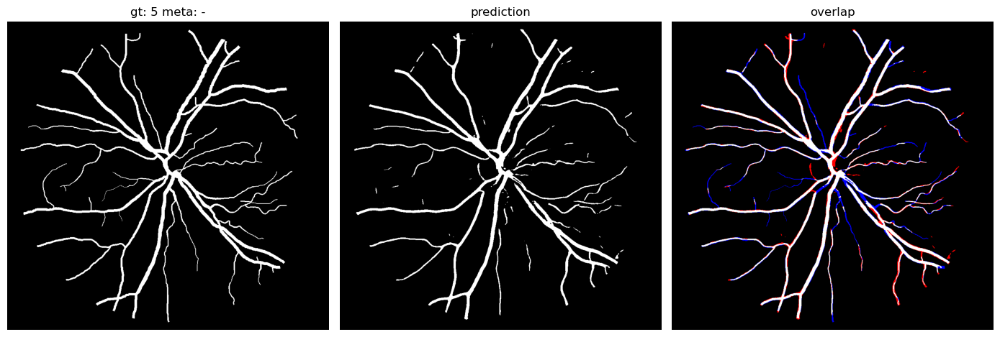

In [26]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

## SME model - with metadata and SE blocks

In [27]:
model_restored = models.UNet3SEbMetaSE(n_channels=3, n_classes=2, meta_length = 2, bilinear=False).to(device)

exp = "sme"
best_model = "best_model.pt"
model_name = os.path.join(root_exp, exp, saved_models, best_model)
print(model_name)
model_weights = torch.load(model_name)    
model_restored.load_state_dict(model_weights)
print("Model restored")

../experiments/sme/saved_models/best_model.pt
Model restored


In [28]:
predictions = predict_batch(model_restored, dataloader_test, device, with_meta = True, regression = False, dtype = "uint8" )
du.print_info(predictions)

arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.06942602324546769 arr.dtype=dtype('uint8')


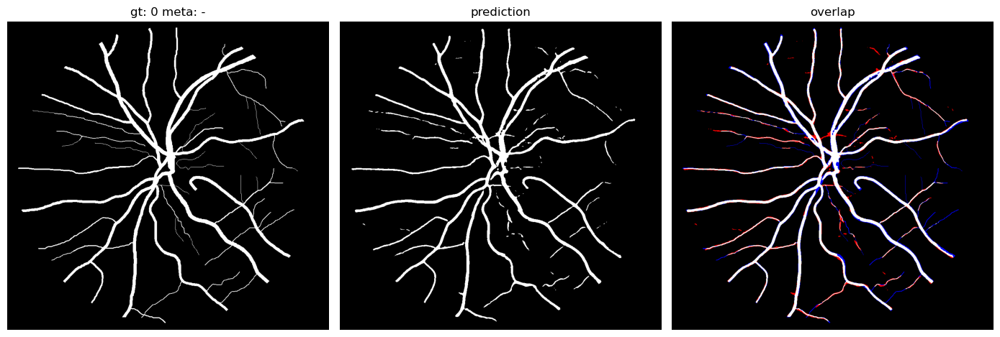

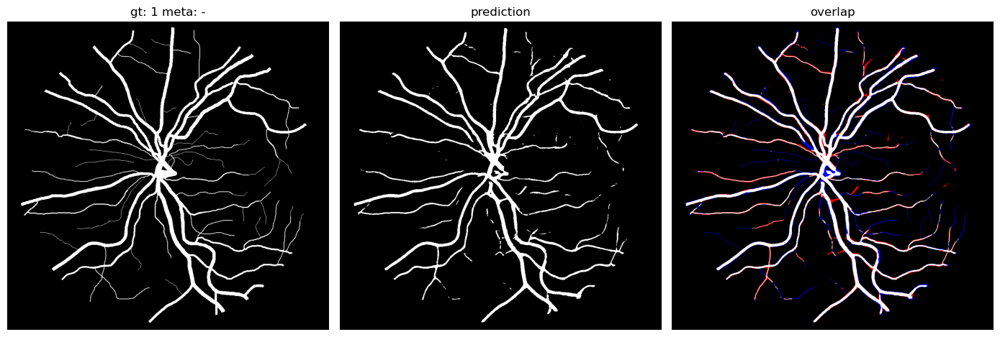

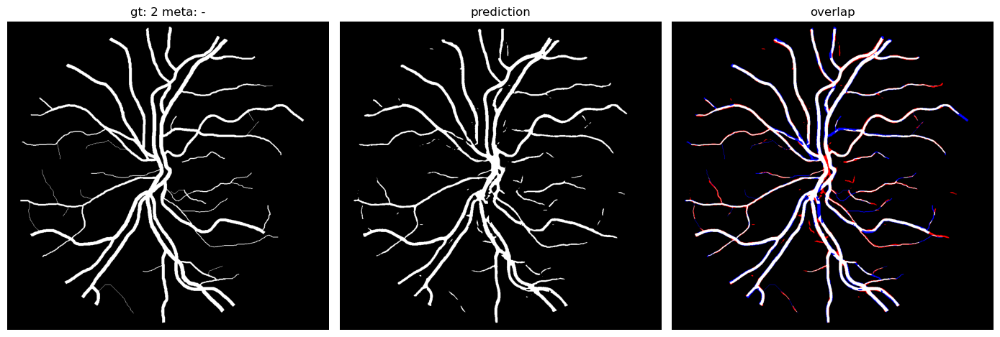

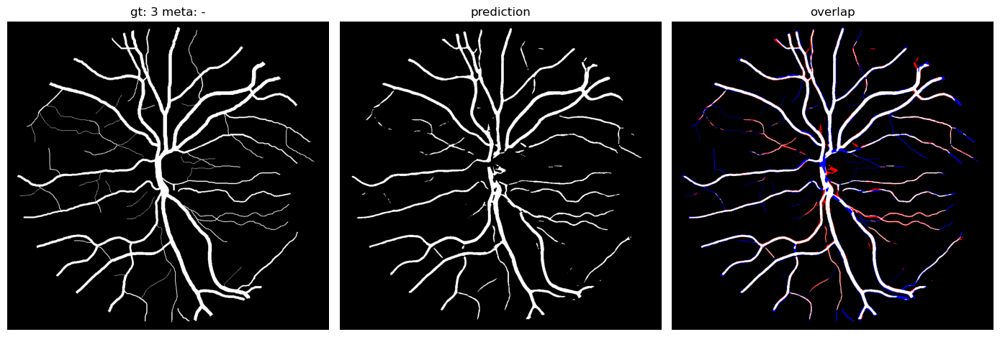

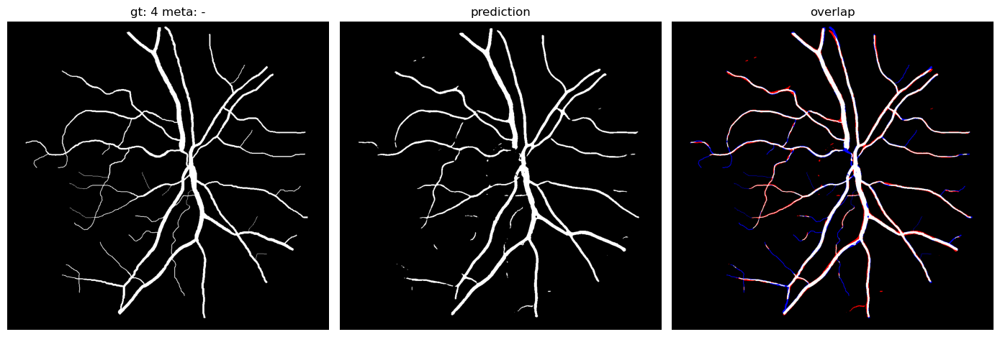

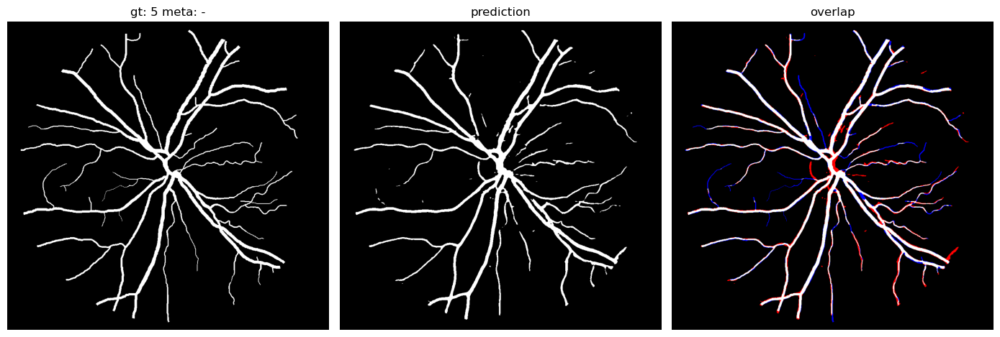

In [29]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

### SME model - prediction with "coarse" style

In [30]:
test_idx_coarse = ['COARSE'] * len(test_idx)
print(test_idx_coarse)

dataset_test_coarse = CustomDataSet(inputs=test_data,
                                        targets=test_masks,
                                        metalabels=test_idx_coarse,
                                        mmap = metamap,
                                        transform=transforms_test)

    
print(f"{len(dataset_test) = }") 

dataloader_test_coarse = DataLoader(dataset=dataset_test_coarse,
                                    batch_size=batch_size,
                                    shuffle=False)

print(f"{len(dataloader_test_coarse) = }")
print("Data prepared")

['COARSE', 'COARSE', 'COARSE', 'COARSE', 'COARSE', 'COARSE']
len(dataset_test) = 6
len(dataloader_test_coarse) = 1
Data prepared


In [31]:
predictions = predict_batch(model_restored, dataloader_test_coarse, device, with_meta = True, regression = False, dtype = "uint8" )
du.print_info(predictions)

arr.shape=(6, 960, 999)  arr.max()=1   arr.min()=0  arr.mean()=0.0656150942609276 arr.dtype=dtype('uint8')


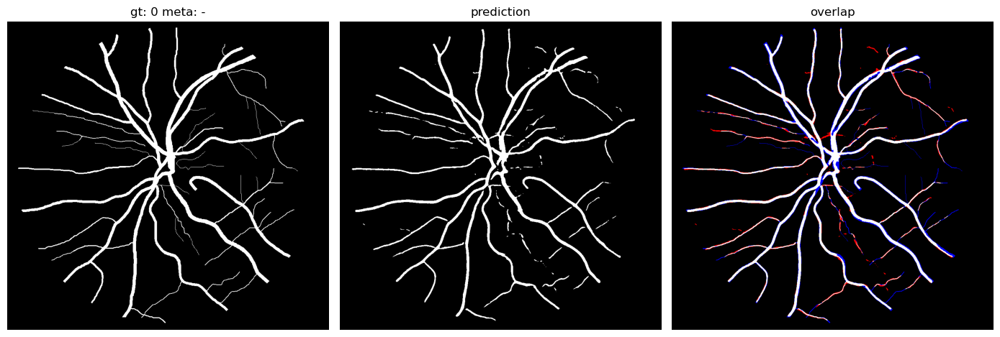

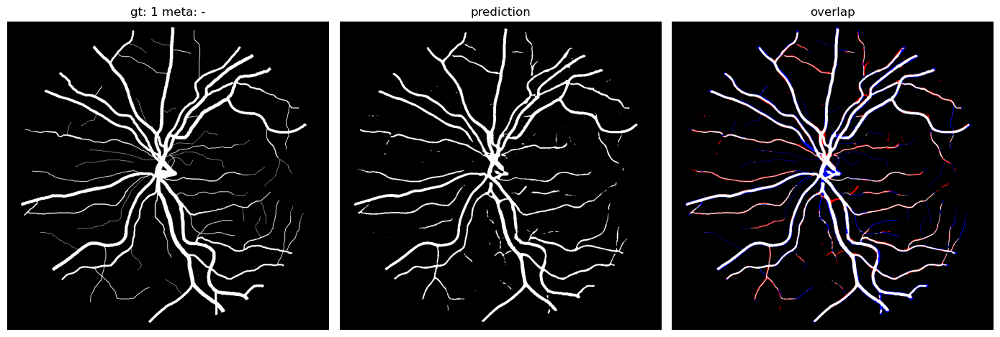

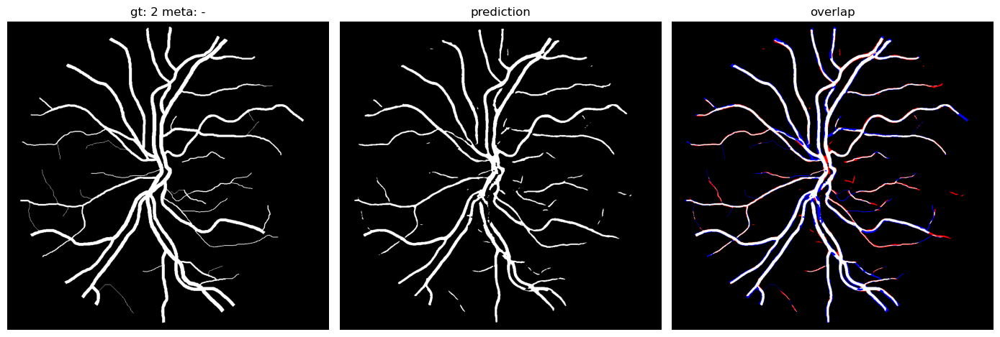

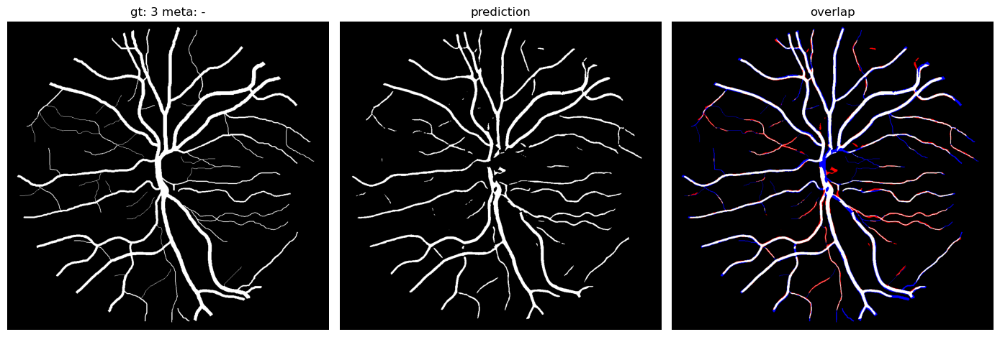

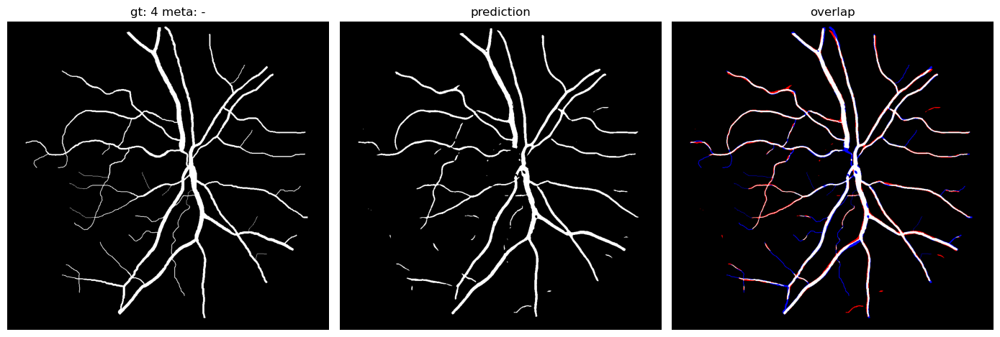

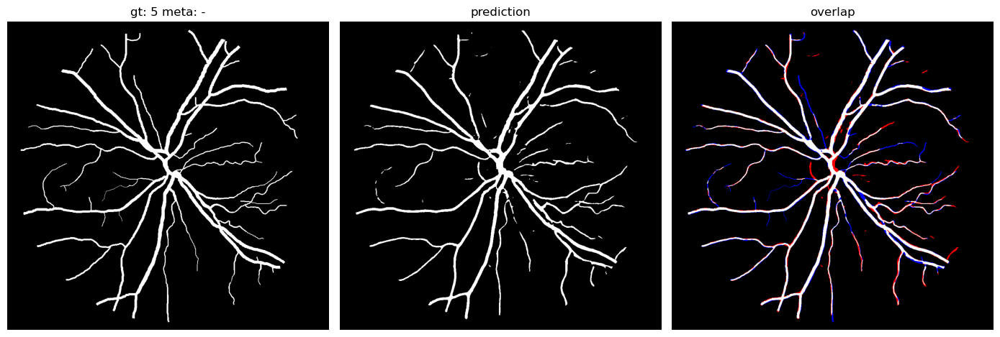

In [32]:
for i, (img, gt, pred) in enumerate(zip(test_data, test_masks, predictions)):
    over = overlap(gt, pred)
    show_examples(name = str(i), image = gt, mask = pred, gt = over, cline = "-", figsize=(14, 18), imtitle = "gt", msk1_title = "prediction", msk2_title = "overlap" )

In [33]:
from utils.metrics import *

iou = iou_score_total(test_masks, predictions)
dice = dice_score_total(test_masks, predictions)
iou_list = iou_score_piecewise(test_masks, predictions)
dice_list = dice_score_piecewise(test_masks, predictions)
ixx =  ["total"] +  list(range(len(iou_list)))

print(f"{iou = }, {dice = }")

data = {
        "iou": [iou]+iou_list,
        "dice": [dice] + dice_list   
        }

df = pd.DataFrame(data, index = ixx)
df

iou = 0.6803, dice = 0.8097


,iou,dice
total,0.6803,0.8097
0,0.6963,0.8209
1,0.6861,0.8138
2,0.6860,0.8138
3,0.6470,0.7857
4,0.6807,0.8101
5,0.6880,0.8152


In [34]:
df.to_csv ('metrics_sme_coarse.csv', header=True)

## Metrics summary

In [56]:
base_folders = ["reference_sub", "reference", "sme_dummy", "film", "me", "sme"]
folders = base_folders + ["sme"]
titles = ["reference\nsub", "reference", "sme\ndummy", "film", "me", "sme", "sme\ncoarse"]
csvs = ["metrics.csv"] * len(base_folders) + ["metrics_sme_coarse.csv"]

accum = []
for exp, title, csv in zip(folders, titles, csvs):
    pth = os.path.join(root_exp, exp, csv)
    df = pd.read_csv(pth, index_col=[0])
    total = df.iloc[0].values
    accum.append(total)

npacc = np.stack(accum)
npacc

array([[0.6148, 0.7615],
       [0.6847, 0.8128],
       [0.6945, 0.8197],
       [0.6808, 0.8101],
       [0.6982, 0.8223],
       [0.7012, 0.8243],
       [0.6803, 0.8097]])

In [57]:
data = {
            "iou_total": npacc[:, 0],
            "dice_total": npacc[:, 1]   
            }

df = pd.DataFrame(data, index = titles)
df

,iou_total,dice_total
reference\nsub,0.6148,0.7615
reference,0.6847,0.8128
sme\ndummy,0.6945,0.8197
film,0.6808,0.8101
me,0.6982,0.8223
sme,0.7012,0.8243
sme\ncoarse,0.6803,0.8097


In [58]:
df.to_csv ('metrics_total.csv', header=True)

### Plotting

In [59]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import matplotlib

df = pd.read_csv('metrics_total.csv', index_col=[0])
df

,iou_total,dice_total
reference\nsub,0.6148,0.7615
reference,0.6847,0.8128
sme\ndummy,0.6945,0.8197
film,0.6808,0.8101
me,0.6982,0.8223
sme,0.7012,0.8243
sme\ncoarse,0.6803,0.8097


In [60]:
matplotlib.rcParams.update({'font.size': 16})

models = df.index.values
#scores_iou = [0.8311, 0.8314, 0.8487, 0.8493, 0.8327]
dfs = df.sort_values(by=['iou_total'], ascending = False)
dfs

,iou_total,dice_total
sme,0.7012,0.8243
me,0.6982,0.8223
sme\ndummy,0.6945,0.8197
reference,0.6847,0.8128
film,0.6808,0.8101
sme\ncoarse,0.6803,0.8097
reference\nsub,0.6148,0.7615


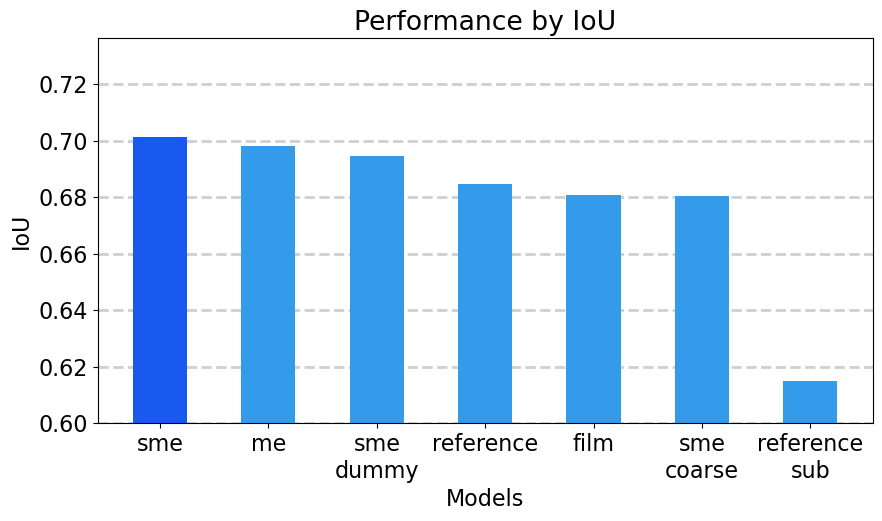

In [68]:
fig = plt.figure(figsize = (10, 5))
plt.rc('axes', axisbelow=True)

#colors = ['slateblue',  'purple', 'darkcyan', 'olive', 'darkgreen', 'maroon', 'blue', 'darkviolet' ]
#colors = ['slateblue',  'purple', 'darkcyan', 'olive', 'darkgreen', 'maroon', 'blue']
colors = ['#1859f0'] + ['#349beb'] * 6
plt.bar(dfs.index.values, dfs.iou_total, color = colors,   #color ='maroon',
        width = 0.5) 
plt.ylim(ymin=0.6)
plt.xlabel("Models")
plt.ylabel("IoU")
plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.5)
plt.title("Performance by IoU")
plt.show()

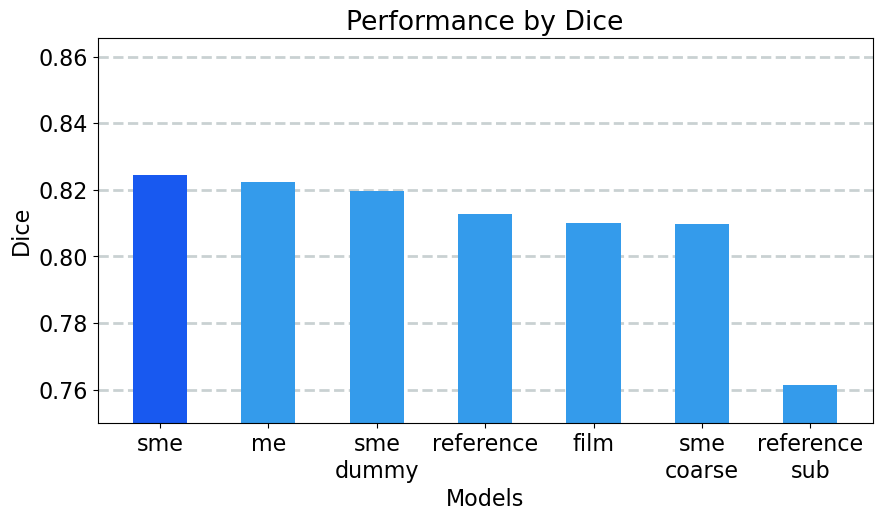

In [69]:
fig = plt.figure(figsize = (10, 5))
plt.rc('axes', axisbelow=True)

dfs = df.sort_values(by=['dice_total'], ascending = False)

plt.bar(dfs.index.values, dfs.dice_total, color = colors,   #color ='maroon',
        width = 0.5) 
plt.xlabel("Models")
plt.ylim(ymin=0.75)
plt.ylabel("Dice")
plt.grid(color='#95a5a6', linestyle='--', linewidth=2, axis='y', alpha=0.5)
plt.title("Performance by Dice")
plt.show()